The purpose of this notebook is analyze and understand the smoker's dataset and build an ML model to predict if a person is a smoker or not.
This notebook is considered complete once every section is completed. 

## Sections 
1. Perform EDA
2. Perform Feature Selection and Feature Engineering 
3. Build and evaluate ML models 
4. Report results to co-workers 


-----

### Section 1: Exploratory Data Analysis 

The purpose of this notebook is to explore and understand each of the columns and how they help predict if a person is a smoker. This section is considered complete when the following tasks are completed: 

1. Data Quality checks are performed 
2. Basic correlations are calculated 
3. Outliers are identifed and removed 




In [1]:
import numpy as np
import pandas as pd  
import plotly.express as px
from sklearn.decomposition import PCA
from scipy import stats
from sklearn.feature_selection import VarianceThreshold
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import ParameterGrid

In [2]:

df_train = pd.read_csv("../playground-series-s3e24/train.csv", index_col='id')
df_train.head()

,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,...,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
id,,,,,,,,,,,,,,,,,,,,,
0,55,165,60,81.0,0.5,0.6,1,1,135,87,...,40,75,16.5,1,1.0,22,25,27,0,1
1,70,165,65,89.0,0.6,0.7,2,2,146,83,...,57,126,16.2,1,1.1,27,23,37,1,0
2,20,170,75,81.0,0.4,0.5,1,1,118,75,...,45,93,17.4,1,0.8,27,31,53,0,1
3,35,180,95,105.0,1.5,1.2,1,1,131,88,...,38,102,15.9,1,1.0,20,27,30,1,0
4,30,165,60,80.5,1.5,1.0,1,1,121,76,...,44,93,15.4,1,0.8,19,13,17,0,1


### Data Quality Checks 

In [3]:
df_train.isnull().sum()

age                    0
height(cm)             0
weight(kg)             0
waist(cm)              0
eyesight(left)         0
eyesight(right)        0
hearing(left)          0
hearing(right)         0
systolic               0
relaxation             0
fasting blood sugar    0
Cholesterol            0
triglyceride           0
HDL                    0
LDL                    0
hemoglobin             0
Urine protein          0
serum creatinine       0
AST                    0
ALT                    0
Gtp                    0
dental caries          0
smoking                0
dtype: int64

In [4]:
df_train.dtypes

age                      int64
height(cm)               int64
weight(kg)               int64
waist(cm)              float64
eyesight(left)         float64
eyesight(right)        float64
hearing(left)            int64
hearing(right)           int64
systolic                 int64
relaxation               int64
fasting blood sugar      int64
Cholesterol              int64
triglyceride             int64
HDL                      int64
LDL                      int64
hemoglobin             float64
Urine protein            int64
serum creatinine       float64
AST                      int64
ALT                      int64
Gtp                      int64
dental caries            int64
smoking                  int64
dtype: object

In [5]:
# do some columns like the eyesights and Gtp have outlier values?
df_train.describe()

,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,...,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
count,159256.000000,159256.000000,159256.000000,159256.000000,159256.000000,159256.000000,159256.000000,159256.000000,159256.000000,159256.000000,...,159256.000000,159256.000000,159256.000000,159256.000000,159256.000000,159256.000000,159256.000000,159256.000000,159256.000000,159256.000000
mean,44.306626,165.266929,67.143662,83.001990,1.005798,1.000989,1.023974,1.023421,122.503648,76.874071,...,55.852684,114.607682,14.796965,1.074233,0.892764,25.516853,26.550296,36.216004,0.197996,0.437365
std,11.842286,8.818970,12.586198,8.957937,0.402113,0.392299,0.152969,0.151238,12.729315,8.994642,...,13.964141,28.158931,1.431213,0.347856,0.179346,9.464882,17.753070,31.204643,0.398490,0.496063
min,20.000000,135.000000,30.000000,51.000000,0.100000,0.100000,1.000000,1.000000,77.000000,44.000000,...,9.000000,1.000000,4.900000,1.000000,0.100000,6.000000,1.000000,2.000000,0.000000,0.000000
25%,40.000000,160.000000,60.000000,77.000000,0.800000,0.800000,1.000000,1.000000,114.000000,70.000000,...,45.000000,95.000000,13.800000,1.000000,0.800000,20.000000,16.000000,18.000000,0.000000,0.000000
50%,40.000000,165.000000,65.000000,83.000000,1.000000,1.000000,1.000000,1.000000,121.000000,78.000000,...,54.000000,114.000000,15.000000,1.000000,0.900000,24.000000,22.000000,27.000000,0.000000,0.000000
75%,55.000000,170.000000,75.000000,89.000000,1.200000,1.200000,1.000000,1.000000,130.000000,82.000000,...,64.000000,133.000000,15.800000,1.000000,1.000000,29.000000,32.000000,44.000000,0.000000,1.000000
max,85.000000,190.000000,130.000000,127.000000,9.900000,9.900000,2.000000,2.000000,213.000000,133.000000,...,136.000000,1860.000000,21.000000,6.000000,9.900000,778.000000,2914.000000,999.000000,1.000000,1.000000


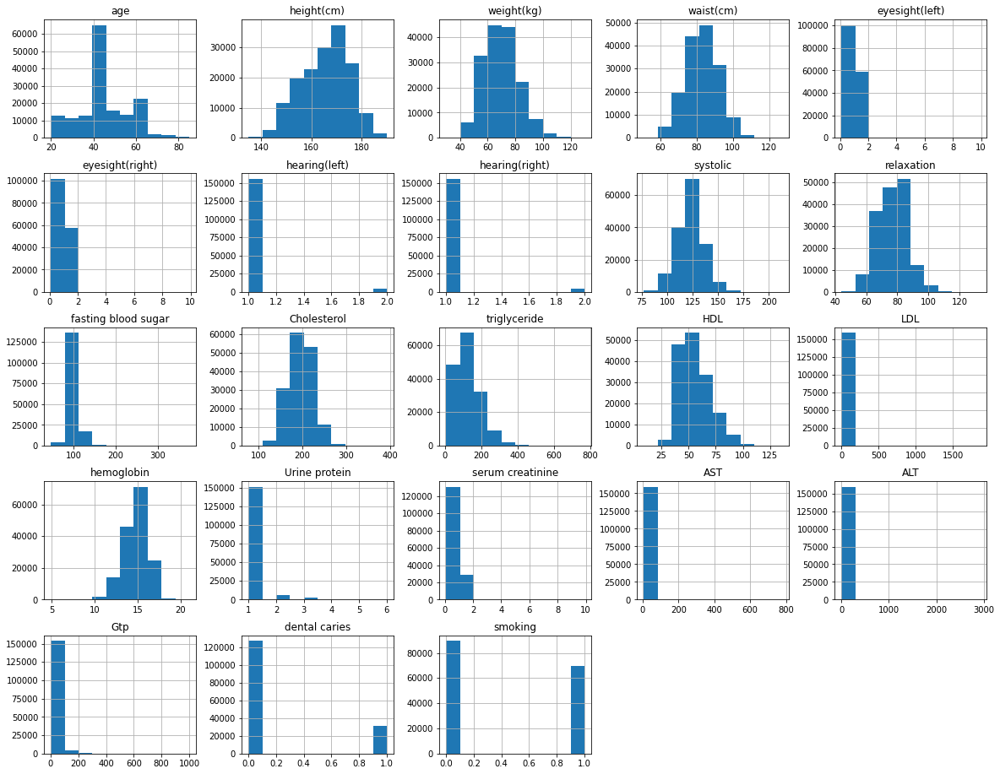

In [6]:
# univariate distributions 
df_train.hist(figsize=(20,16));

### Observations 

- Features AST, ALT, hearing, and others likely have `outliers` (reliable measurements ?) 
- Features height, weight, waist and others are approximately `normal distributions` 
- Dental Caries is the single input feature that is `binary` 

In [7]:
# use more robust spearman correlation 
df_corr = df_train.corr(method='spearman')
fig = px.imshow(df_corr, text_auto=True)
fig.show()

In [8]:
# bivariate distributions 
fig = px.scatter_matrix(df_train, 
                        dimensions=["waist(cm)", "age", "weight(kg)", "height(cm)", "HDL", 'triglyceride'])
fig.show()

### Observations 

- Taller people tend to weight more and have a larger waist 
- Older people tend to weight less 
- Triglycerides tend to be lower with people who have higher levels of HDL (good cholesteral)
- Features in scatter plot have linear correlations ( or no correlation like HDL and age)
- Linear model should be included in trained model set 

In [9]:
# perform Dimensionality Reduction to see if largely linear features are easily seperated 

# PCA into 3D 
# appears that a linear model would identify most people correctly but a non-linear model should perform better 
pca = PCA(n_components=3)
pca_vecs = pca.fit_transform(df_train[df_train.columns[:-1]]) # exclude smoking col

fig = px.scatter_3d(pca_vecs, x=0, y=1, z=2, color=df_train['smoking'])
fig.show()

In [10]:
# PCA into 3D 
# appears that a linear model would identify most people correctly but a non-linear model should perform better 
# outliers are more visable here - should they be thrown out of the dataset? Are those measurements reliable?
pca = PCA(n_components=2)
pca_vecs = pca.fit_transform(df_train[df_train.columns[:-1]]) # exclude smoking col

fig = px.scatter(pca_vecs, x=0, y=1, color=df_train['smoking'])
fig.show()

In [11]:
def remove_outliers(dataframe:pd.DataFrame, sigmas=3): 
    """ Remove all rows that have outliers in at least on column. 
        An outlier is defined as existing more than <sigma> standard deviations away from the mean. 
        Normal distributions are assumed for all features. 
    """
    return dataframe[(np.abs(stats.zscore(dataframe)) < sigmas).all(axis=1)]
df_outliers_removed = remove_outliers(df_train)
df_outliers_removed

,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),hearing(left),hearing(right),systolic,relaxation,...,HDL,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking
id,,,,,,,,,,,,,,,,,,,,,
0,55,165,60,81.0,0.5,0.6,1,1,135,87,...,40,75,16.5,1,1.0,22,25,27,0,1
2,20,170,75,81.0,0.4,0.5,1,1,118,75,...,45,93,17.4,1,0.8,27,31,53,0,1
3,35,180,95,105.0,1.5,1.2,1,1,131,88,...,38,102,15.9,1,1.0,20,27,30,1,0
4,30,165,60,80.5,1.5,1.0,1,1,121,76,...,44,93,15.4,1,0.8,19,13,17,0,1
6,45,160,55,69.0,1.5,1.2,1,1,150,88,...,69,122,13.0,1,0.7,17,12,16,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
159251,40,155,45,69.0,1.5,2.0,1,1,127,80,...,72,159,14.5,1,0.8,25,26,13,0,0
159252,50,155,75,82.0,1.0,1.0,1,1,120,80,...,64,108,14.5,1,0.6,21,20,18,0,0
159253,40,160,50,66.0,1.5,1.0,1,1,114,70,...,87,93,10.9,1,0.6,15,9,12,0,0


### Notes

- Outlier removal from train set may negatively affect model performance on test set depending on test set distributions 
- Could filter out outliers in test set as well and provide caveate on model usage, that only certain column ranges provide reliable results 

----

#### Section 2: Feature Selection and Feature Engineering 

This section is considered complete once all of the following tasks are completed. 

1. High and low quality(and predictive) columns are identified and selected for modeling
2. (Optional) Perform feature engineering 

In [12]:
# remove zero-variance features from dataset
# allow models to perform more discrimate feature selection 

def remove_zero_var_feats(df:pd.DataFrame) -> pd.DataFrame:
    var_thres = VarianceThreshold()
    data = var_thres.fit_transform(df)
    # boolean indicating if feature has zero variance
    is_non_zero_var = ~(var_thres.variances_ == 0.)
    cols = df.columns[is_non_zero_var]
    return df[cols]

df_outliers_removed = remove_zero_var_feats(df_outliers_removed)

----

### Section 3: Build and evaluate ML models 

In this section we'll build at least 1 linear model and 3 non-linear models have been trained, evaulated, and a best performing model has been selected based on several performance metrics. 


This section is considered complete once all of the following tasks are completed. 

1. Calculate baseline 
2. Train Logistic Regression
3. Train Random Forest 
4. Evaluate model performance on roc_auc


In [14]:
# 1. Calculate baseline
# percent of users that are smokers, i.e. majority class
# basically, the dataset is weakly biased towards the Negative case 

def baseline_acc(df:pd.DataFrame, label_col:str) -> float:
    n_smokers = df[label_col].sum()
    n_total = df.shape[0]
    return 1. - (n_smokers/n_total)

baseline_acc(df_outliers_removed, label_col='smoking')

0.5656741674167416

In [15]:
class BuildModels:
    def __init__(self):
        self.scale=None
        self.model_scores = dict()
        self.trained_models = dict()

        self.rf_param_grid = {'n_estimators': [100], 
               #'max_depth': [None, 6, 12],
               'min_samples_split': [2, 5],
               'max_features': [None]
               }

        self.lr_param_grid = {'penalty':['l1', 'l2'], 
                        'max_iter':[1000],
                        }
    
        self.models_params = [
            ['LogisticRegression', LogisticRegression(), self.lr_param_grid], 
            ['RandomForestClassifier', RandomForestClassifier(), self.rf_param_grid]
                              ]

    def split_data(self, X:pd.DataFrame, y:pd.Series, scale=True):
        self.X_train, self.X_test, self.y_train, self.y_test = train_test_split(X, 
                                                                                y, 
                                                                                test_size=0.30, 
                                                                                random_state=42)

        self.scale = scale
        # rescale dataset between 0 and 1 
        if self.scale:
            self.scaler = StandardScaler()
            self.X_train = self.scaler.fit_transform(self.X_train)
            self.X_test = self.scaler.transform(self.X_test)

    def train_model(self, model, param_grid, metric):
        self.gs = GridSearchCV(estimator=model, 
                        param_grid=param_grid, 
                        n_jobs=10, 
                        scoring=metric
                        )
        self.gs.fit(self.X_train, self.y_train)

    def train_models(self, metric='roc_auc'):
        for name, model, params in self.models_params:           
            self.train_model(model, param_grid=params, metric=metric)
            self.model_scores[name] = self.evaluate_model()
            self.trained_models[name] = self.gs

    def evaluate_model(self):
        self.y_train_pred = self.gs.predict(self.X_train)
        self.y_test_pred = self.gs.predict(self.X_test)

        return roc_auc_score(self.y_test, self.gs.predict_proba(self.X_test)[:, 1])  

In [68]:
df_outliers_removed

,age,height(cm),weight(kg),waist(cm),eyesight(left),eyesight(right),systolic,relaxation,fasting blood sugar,Cholesterol,...,LDL,hemoglobin,Urine protein,serum creatinine,AST,ALT,Gtp,dental caries,smoking,random_feat
id,,,,,,,,,,,,,,,,,,,,,
0,55,165,60,81.0,0.5,0.6,135,87,94,172,...,75,16.5,1,1.0,22,25,27,0,1,0.226978
2,20,170,75,81.0,0.4,0.5,118,75,79,178,...,93,17.4,1,0.8,27,31,53,0,1,-0.687195
3,35,180,95,105.0,1.5,1.2,131,88,91,180,...,102,15.9,1,1.0,20,27,30,1,0,-1.626495
4,30,165,60,80.5,1.5,1.0,121,76,91,155,...,93,15.4,1,0.8,19,13,17,0,1,0.446810
6,45,160,55,69.0,1.5,1.2,150,88,84,222,...,122,13.0,1,0.7,17,12,16,0,0,-0.331168
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
159251,40,155,45,69.0,1.5,2.0,127,80,64,238,...,159,14.5,1,0.8,25,26,13,0,0,-0.966463
159252,50,155,75,82.0,1.0,1.0,120,80,89,213,...,108,14.5,1,0.6,21,20,18,0,0,1.121265
159253,40,160,50,66.0,1.5,1.0,114,70,84,189,...,93,10.9,1,0.6,15,9,12,0,0,-0.873518


In [80]:
# add normally distributed feature to check if feature weights perform better than random 
df_outliers_removed['random_feat'] = np.random.normal(size=df_outliers_removed.shape[0])
x_cols = df_outliers_removed.drop('smoking', axis=1).columns
X = df_outliers_removed.drop('smoking', axis=1)
y = df_outliers_removed.smoking

/Users/alexanderbarriga/opt/anaconda3/envs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [73]:
build = BuildModels()
build.split_data(X,y)
build.train_models()

/Users/alexanderbarriga/opt/anaconda3/envs/py37/lib/python3.7/site-packages/sklearn/model_selection/_split.py:1978: FutureWarning:

The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.

/Users/alexanderbarriga/opt/anaconda3/envs/py37/lib/python3.7/site-packages/sklearn/linear_model/logistic.py:432: FutureWarning:

Default solver will be changed to 'lbfgs' in 0.22. Specify a solver to silence this warning.

/Users/alexanderbarriga/opt/anaconda3/envs/py37/lib/python3.7/site-packages/sklearn/model_selection/_split.py:1978: FutureWarning:

The default value of cv will change from 3 to 5 in version 0.22. Specify it explicitly to silence this warning.



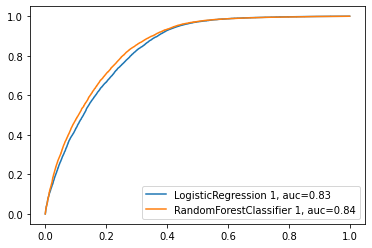

In [74]:
from sklearn import metrics
import matplotlib.pyplot as plt

# models perform almmost identically 
# both models provide different interpretations of variable relationships
plt.figure(0).clf()
fpr, tpr, thresh = metrics.roc_curve(build.y_test, build.trained_models['LogisticRegression'].best_estimator_.predict_proba(build.X_test)[:, 1])
plt.plot(fpr,tpr,label="LogisticRegression 1, auc="+str(build.model_scores['LogisticRegression'])[:4])

fpr, tpr, thresh = metrics.roc_curve(build.y_test, build.trained_models['RandomForestClassifier'].best_estimator_.predict_proba(build.X_test)[:, 1])
plt.plot(fpr,tpr,label="RandomForestClassifier 1, auc="+str(build.model_scores['RandomForestClassifier'])[:4])
plt.legend(loc=0);

####  Interpret Logistic Regression Coefficients

In [81]:
log_odds = build.trained_models['LogisticRegression'].best_estimator_.coef_[0].reshape(21,)
odds = np.exp(build.trained_models['LogisticRegression'].best_estimator_.coef_[0]).reshape(21,)

df_model_results = pd.DataFrame(index=x_cols, columns=['log_odds', 'odds', 'percent_change'])
df_model_results.log_odds = log_odds
df_model_results.odds = odds
df_model_results.percent_change = (odds - 1) * 100
df_model_results

,log_odds,odds,percent_change
age,-0.005065,0.994948,-0.505245
height(cm),0.774284,2.169040,116.903956
weight(kg),-0.300978,0.740094,-25.990590
waist(cm),0.056599,1.058232,5.823178
eyesight(left),0.010203,1.010255,1.025480
eyesight(right),0.041973,1.042866,4.286628
systolic,-0.165428,0.847531,-15.246927
relaxation,0.061501,1.063431,6.343138
fasting blood sugar,0.092760,1.097199,9.719855
Cholesterol,0.116831,1.123929,12.392932


#### Interpretation 

- Each input variable's weight (coefficent) is listed under `log_odds`, which is the interpretation of the weight. 
- Taking the exponential of the log_odds gives us the `odds` that a person is a smoker given a 1 unit increase of the input variable. 
- Odds can be reinterpreted as percent change. 

Imagine that there is a person for which we have just measured their `height`, `systolic`, and `fasting blood sugar`. Each biometric has changed by 1 unit. 

Their `height` increasing by 1 cm means the odds of them being a smoker is 2.16, just over a 2:1 odds ratio. We can also say that the probability that they are a smoker went up by 116%, in other words it just little more than doubled. Why might these results make sense? Typically kids and young adults don't smoke because they are underage and they are usually not as tall as fully grown adults. So an increase in height implies an increase in age and there are more adult smokers than underage smokers (assumption), therefore the probability must increases.


Their `systolic` blood pressure increasing by 1 unit means the odds of them being a smoker is 0.84, close to a 4:5 odds ratio. An alternative interpreation: the probability that they are a smoker dropped by 15.2%. As `systolic` blood pressure increases, the person is less likely a smoker. 

Their `fasting blood sugar` increasing by 1 unit means that the odds of them being a smoker is 1.09, just over a 1:1 ratio. The probability that they are a smoker increased by 9%. As `fasting blood sugar` increases, the person is more likely a smoker. 

#### Interpret Random Forest Feature Importance Scores 

In [83]:
# std of tree's values for feature importance
fi_std = np.std([tree.feature_importances_ for tree in build.trained_models['RandomForestClassifier'].best_estimator_], axis=0)
fi_mean = build.trained_models['RandomForestClassifier'].best_estimator_.feature_importances_

df_feat_imp = pd.DataFrame(index=x_cols, columns=['feat_imp', 'error'])
df_feat_imp.feat_imp = fi_mean
df_feat_imp.error = fi_std
df_feat_imp.sort_values(by='feat_imp', ascending=False, inplace=True)
df_feat_imp

,feat_imp,error
height(cm),0.240673,0.002569
Gtp,0.088352,0.003859
hemoglobin,0.086685,0.002382
triglyceride,0.068887,0.004407
random_feat,0.052572,0.002123
LDL,0.045072,0.002164
fasting blood sugar,0.040942,0.001920
ALT,0.040146,0.002082
waist(cm),0.039203,0.001623
Cholesterol,0.038526,0.002116


<AxesSubplot:>

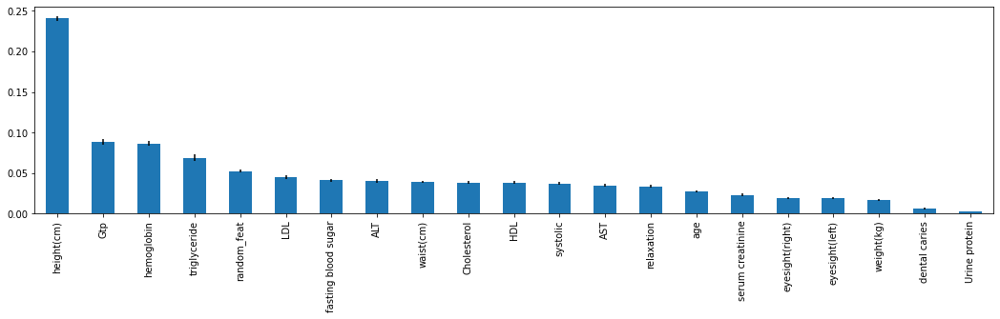

In [84]:
df_feat_imp.feat_imp.plot(kind='bar',yerr=df_feat_imp.error, figsize=(18,4))

#### Interpretation

Something that Random Forest can tell us about features that Logistic Regression can't is how importance the feature is to predicting the class. By including a normal distribution as a feature, it can tells us which features are perform worst than random at predicing the class. 

`Feature Importance` is a measure of impurity reduction. The impurity scores quantifies the class imbalance within a tree leaf. A DecisionTree will try every feature in the feature set when deciding which branch to create. The feature that can create the purist leaves (label homogeneity) will have the lowest impurity score and will be choosen as the feature used to split the branch. 

Common impurity metrics used are `gini` and `entropy`. 

80% of the `Smoking` feature set is useless at predicting the class, only `height`, `Gtp`, `hemoglobin`, and `triglycerides`perform better than random. Random Forest's feature importance is useful for selecting a subset of features to improve model score. 
    1. Feature Selection: use feature weights to filter out features that don't contribute to improving prediction score. 
    2. Use surviving feature set to re-train models. 
    3. Should lead to higher prediction scores with a smaller feature set. 



#### 4. Report results to co-workers 

This section is complete once a summary of the EDA and modeling results are communiated in concise and coherent way. 

- Most features are approxiate normal dist
- Some features have outliers 
- Outliers where identifed using PCA and then removed from the dataset
- Feature Selection 
    - Zero Variance features were removed
    - Scale features to a range between 0 and 1 
    - Include a random feature (normal dist) to help further filter out features in future modeling iterations 
- Modeling 
    - Trained Logistic Regression and Random Forest 
    - Optimzed modeles using auc_roc_score ( we want the model that perform best over all possible decision boundaries)
    - Logistic and RandomForest perform almost identically, scoring a 83% and 84% auc_roc_score respectively. 
- Feature Interpretation
    - RandomForst revealed that all but 4 features (80% of the feature set) perform worse than random at predicting if someone is a smoker. 
    - Logistic provided the odds and perchange changes whenever someone's biometric increases or decreases by 1 unit. 
    - Taken together, we can use RandomForest's importance scores to narrow down the feature set to 4 features than use Logistic to find the odds and perchanges for those predictive features. We can then have a more focused and reliable analysis of how a person's biometrics suggest if they smoke or not. 